# XCO2 tutorial Outline

XCO2 Tutorial Outline

POWER POINT PORTION

1. Introduction to XCO2

2. What is XCO2 and history

3. What can XCO2 show and not show

4. Plotted example of XCO2

5. Measurement Approach

6. Spatial and Temporal Resolution for OCO-2 and OCO-3

7.How do we know the data is good?

8.Where to download the data

9. Product and Naming

10.Documentation for data products


## JUPYTER NOTEBOOK PORTION

Before following along, you will need to download software packages for this portion of the training. This is also what you will need in order to work with the data. We will be working in python, please make sure to have python 3 installed as well as Jupyter Notebook installed.

Please be sure to have these libraries downloaded as well – (list libraries)

OCO-2 Data files are large so it will take some time to download!

1.	Show what happens when we open up Jupyter Notebook (we will provide a path for the demo)
2.	Show code for how we pull the data from the data (File name, date and geolocation)
3.	Example one – XY Plot of XCO2 variation over time for a given location
4.	Example two- Show same plot but over several years
5.	Example three- Same location and time but shown over Google Earth for OCO-2 data
6.	Example four- Same location and time but show over Google Earth for OCO-3 data
7.	Example five – GIF showing OCO-3 data on spinning globe



# Jupyter notebook installation guide

From the list of website you can follow instructions to setup Jupyter Notebook:
* https://jupyter.org/install
* https://www.geeksforgeeks.org/how-to-install-jupyter-notebook-in-windows/
* https://test-jupyter.readthedocs.io/en/latest/install.html
 

## 1. Show what happens when we open up Jupyter Notebook
### Jupyter Notebook Setup guide

In [3]:
from IPython import display

display.IFrame( src="https://test-jupyter.readthedocs.io/en/latest/install.html",\
              width= 600, height= 500)

# Libraries (Package Installation Guide)
- Type the following command in the Anaconda prompt:
- Example: //to install netCDF4 library using <b>Anaconda prompt</b>
    * pip install netCDF4
- Second option: To install multiple libraries from the text file
    * pip install -r requirements.txt
  

## Example to download libaries from Anaconda prompt

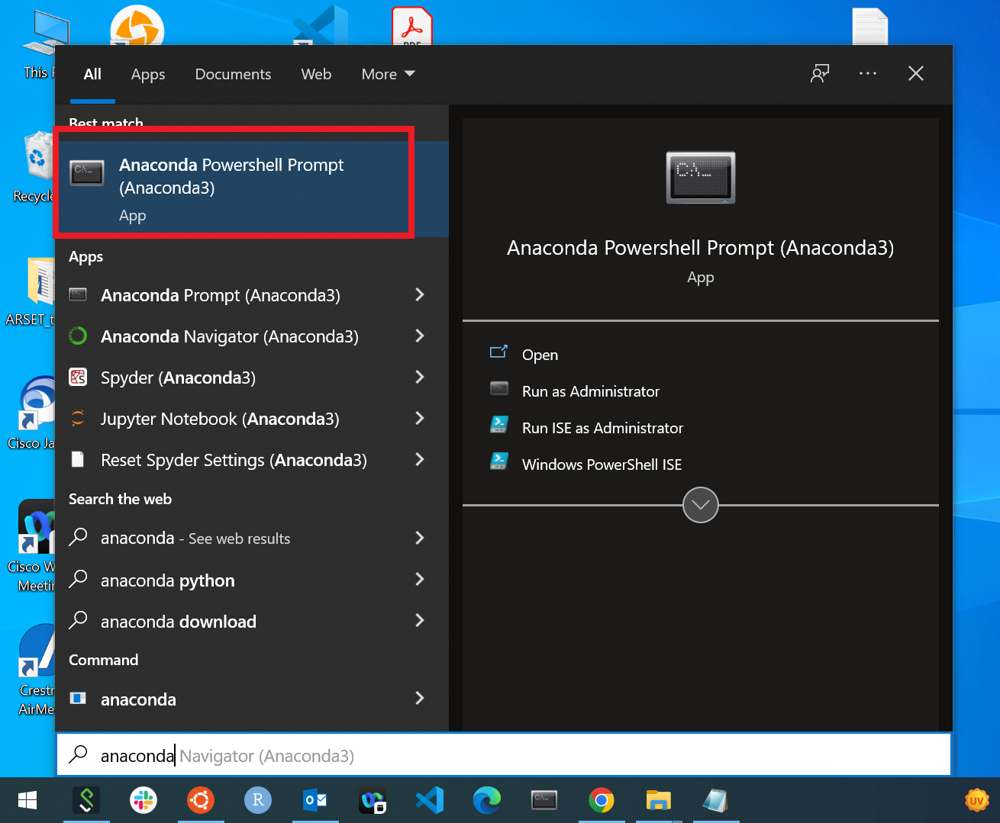

In [4]:
# To display images
from IPython.display import Image

Image('downloading_BASEMAP_whl/locate_anaconda-prompt.png')

### Install single and multiple libararies

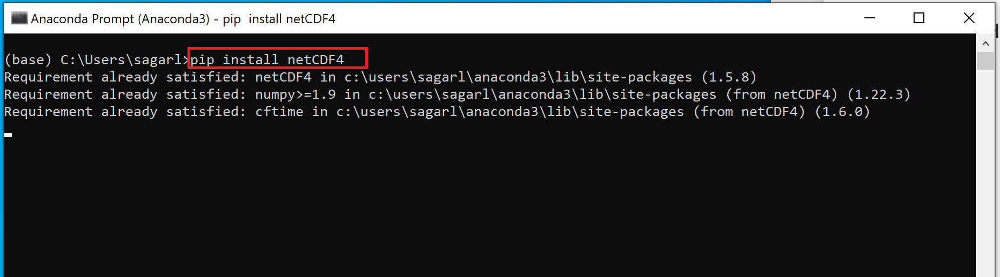

In [5]:
Image('downloading_BASEMAP_whl/package_installation.png')

### Install multiple libraries in a single line

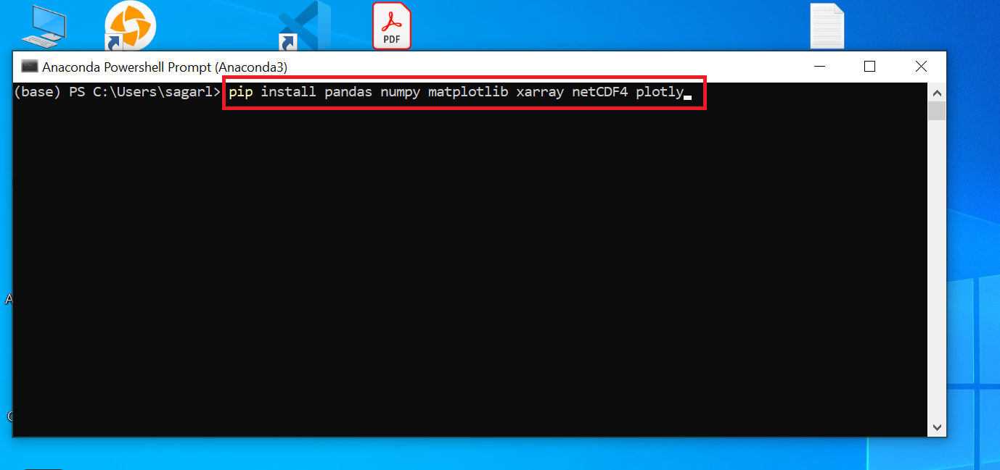

In [6]:
Image('downloading_BASEMAP_whl/install_multiple_libraries.png')

## Import Libaries

In [7]:
# Libraries to open 'netcdf' file
import netCDF4
import xarray

# To pre-process dataframe and use in visualization
import numpy as np
import pandas as pd

# To create visualization, graphs, and plots
import matplotlib.pyplot as plt 
import matplotlib.animation as animation
from mpl_toolkits.basemap import Basemap # to create geo-spatial map, requires dependencies installation
import plotly.express as px
#import cartopy.crs as ccrs

# To Display the content
from IPython.display import display, HTML, Image

### Dependecies/ Wheel files download from following packages
- <b>GDAL, Cartopy, basemap </b>
- EG: pip install <b> path to whl file</b> --user
- https://www.lfd.uci.edu/~gohlke/pythonlibs/#basemap

# 2. Show code for how we pull the data from the data (File name, date and geolocation)

- We can download the files from EarthData
- Requires login credentials and we can create a free account

## NOTE: 
- In this tutorial, we will demonstrate by using the OCO2 datasets which in the same path
of the git repository.
- FILE directory name: 'oco2_data'

### 2.a. Using NetCDF library to read the file
- Example:
    * netCDF4.Dataset(<path to file>)

In [8]:
%%time
data_xco2= netCDF4.Dataset('oco2_data/oco2_LtCO2_190101_B10206Ar_200729172616s.nc4')

Wall time: 198 ms


### Display the content inside file
- variables and attributes

In [9]:
list(data_xco2.variables.keys())

['sounding_id',
 'levels',
 'bands',
 'vertices',
 'footprints',
 'date',
 'latitude',
 'longitude',
 'time',
 'solar_zenith_angle',
 'sensor_zenith_angle',
 'xco2_quality_flag',
 'xco2_qf_bitflag',
 'xco2_qf_simple_bitflag',
 'source_files',
 'file_index',
 'vertex_latitude',
 'vertex_longitude',
 'xco2',
 'xco2_uncertainty',
 'xco2_apriori',
 'pressure_levels',
 'co2_profile_apriori',
 'xco2_averaging_kernel',
 'pressure_weight']

### 2.b Using another library 'Xarray' to read file
- Open the file with xarray library
    * Example: xarray.open_dataset(<path to file>)

In [10]:
df_xr= xarray.open_dataset('../../oco2_LtCO2_190101_B10206Ar_200729172616s.nc4')

NOTE: difference between using netCDF and Xarray library to read files. Xarray allows to read the dateTime attribute in standard datae time format column

## Visualizing the dataset
### using different libraries: Plotly or Basemap

## 1. Plotly
### Setting up Token using Map Box
- Requires map access token to visualize the map
- Create Free acount and generate API Key

- (more brief)

https://account.mapbox.com/

In [11]:
map_token= 'pk.eyJ1Ijoic2FnYXJsaW1idTAiLCJhIjoiY2t2MXhhMm5mNnE5ajJ3dDl2eDZvNTM2NiJ9.1bwmb8HPgFZWwR8kcO5rOA'

# Global Coverage

### Function to visualize the dataset using Plotly


(NOTE): color range fixation

# ISSUE: outliers of the xco2 value can offset the color range

In [12]:
print("MAX: ", np.max(df_xr["xco2"]))
print("MIN: ", np.min(df_xr["xco2"]))

MAX:  <xarray.DataArray 'xco2' ()>
array(448.14862061)
MIN:  <xarray.DataArray 'xco2' ()>
array(343.2739563)


In [13]:
# Create dataframe and columns
df_xco2= pd.DataFrame(columns=[ "Latitude", "Longitude", "DateTime","xco2", "xco2_quality_flag"])

df_xco2["xco2"]= df_xr["xco2"][:]
df_xco2["dateTime"]= df_xr["time"][:]
df_xco2["latitude"]= df_xr["latitude"][:]
df_xco2["longitude"]= df_xr["longitude"][:]
df_xco2["xco2_quality_flag"]= df_xr["xco2_quality_flag"][:]

In [14]:
df_xco2['xco2'].describe()

count    190424.000000
mean        406.882843
std           4.075640
min         343.273956
25%         405.723114
50%         407.217575
75%         408.980972
max         448.148621
Name: xco2, dtype: float64

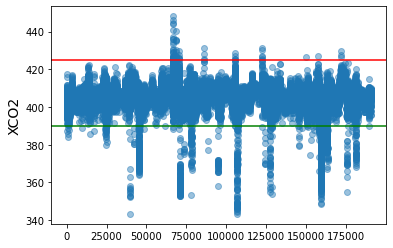

In [15]:
plt.scatter(np.arange(0, len(df_xco2['xco2'])), df_xco2['xco2'], alpha= 0.45)
plt.ylabel('XCO2', fontsize= 14)
plt.axhline(y= 425, c='r')
plt.axhline(y= 390, c= 'green')


# Filtering the XCO2 values between RANGE (390- 415) to reflect the variation

### Enter the min and max XCO2 ppm

In [16]:
max_ppm= float(input("Enter the UPPER bound XCO2 ppm: "))
min_ppm= float(input("Enter the LOWER bound XCO2 ppm: "))

Enter the UPPER bound XCO2 ppm: 415
Enter the LOWER bound XCO2 ppm: 400


In [17]:
%%time
# Filter XCO2 ppm by range 400-415 to reflect the variation
new_data= df_xco2[df_xco2['xco2'] < max_ppm]
new_data= new_data[new_data['xco2'] > min_ppm]

# set mapbox access token
px.set_mapbox_access_token(map_token)

# passing Latitude, Longitude, and Xco2 product
# Retrieve all data and passing into function
fig= px.scatter_mapbox(new_data,
                      lat= new_data['latitude'],
                      lon= new_data['longitude'],
                      color= new_data['xco2'],        
                       zoom= 0,
                      size_max= 0.25,

                      color_continuous_scale= ["yellow", "orange", "red"]
#                       color_continuous_scale= ["blue", "green", "red"]
#                      hover_name='DateTime'
                      )

fig.update_layout(
    autosize=True,
    hovermode='closest',
    mapbox=dict(
        accesstoken=map_token,
        bearing=0,
        pitch=0,
        zoom=0,
        style="white-bg",
        layers=[{
            "below":'traces',
            "sourcetype": "raster",
            "sourceattribution": "United States Geological Survey",
            "source": [
                "https://basemap.nationalmap.gov/arcgis/rest/services/USGSImageryOnly/MapServer/tile/{z}/{y}/{x}"
            ]
        }
        ]
    )
    ,title='OCO2- XCO2, Atmospheric Carbon Dioxide'

)

fig.show()

Wall time: 6.83 s


# Subsetting by geographic bounding box:
- Bounding box coordinates to cover Australia
- Filtering the latitude and longitude by coordinates
- Example filtering the data by Australia region

## Spatial subsetting on the coordinates:
- Latitude(South: North)
- Longitude(West: East)
- Enter the coordinates     
- Example: Subsetting by Australia region
    - latitude: (-45.75 : -9)
    - longitude: (110 : 156)

In [18]:
%%time
def subsetting_coordinates(data, South, North, West, East, zoom = 1, darkmap= 0):
    
    # Create dataframe and columns
    df_xco2= pd.DataFrame(columns=[ "Latitude", "Longitude", "DateTime","xco2", "xco2_quality_flag"])
    
    df_xco2["xco2"]= data["xco2"][:]
    df_xco2["dateTime"]= data["time"][:]
    df_xco2["latitude"]= data["latitude"][:]
    df_xco2["longitude"]= data["longitude"][:]
    df_xco2["xco2_quality_flag"]= data["xco2_quality_flag"][:]

    # Passing the new Dataframe and filtering the coordinates by region/ country: 
    df_first= df_xco2[(df_xco2["latitude"] > South) &(df_xco2["latitude"]< North)]
    df_second= df_first[(df_first["longitude"] >West) & (df_first["longitude"] < East)]
    
    
    # set token
    px.set_mapbox_access_token(map_token)

    fig_second= px.scatter_mapbox(df_second,
                          lat= 'latitude',
                          lon= 'longitude',
                          color= 'xco2',
                          zoom= zoom,
                          size_max= 15,
                          )

    if darkmap == 1:
        fig_second.update_layout(
        mapbox_style="dark",
        title='OCO2- XCO2, Atmospheric Carbon Dioxide'

        )
    else:
        fig_second.update_layout(
        mapbox_style="stamen-watercolor",
        title='OCO2- XCO2, Atmospheric Carbon Dioxide'

        )

    fig_second.show()

Wall time: 0 ns


### Australia coordinates: 

* latitude: (-45.75 : -9)
* longitude: (110 : 156)

In [19]:
%%time
subsetting_coordinates(df_xr, -45.75, -9, 110, 156, zoom= 3)

Wall time: 601 ms


### Example: California:
- latitude: (32, 42)
- longitude: (-125.22 , -118)

#### option: Select Dark map option, 'darkmap = 1'

In [20]:
subsetting_coordinates(df_xr, 32,  42, -125.22, -118, zoom= 4, darkmap= 1)

## 2. Basemap

### Guide to download BASEMAP package

* basemap:
Plot on map projections (with coastlines and political boundaries) using matplotlib.

This package depends on the support package basemap-data with the basic basemap data assets, and optionally on the support package basemap-data-hires with high-resolution data assets.

1. Follow the main website instructions to download package
    https://matplotlib.org/basemap/users/installing.html
2. Issues with downloading dependencies:
    https://stackoverflow.com/questions/33020202/how-to-install-matplotlibs-basemap

## Instructions to download the 'Basemap' package
- Requires to download 'whl' file
https://www.lfd.uci.edu/~gohlke/pythonlibs/

* NOTE: If you are on chrome you can search through by keyword:
        - Ctrl + F
        - Search for keyword: basemap

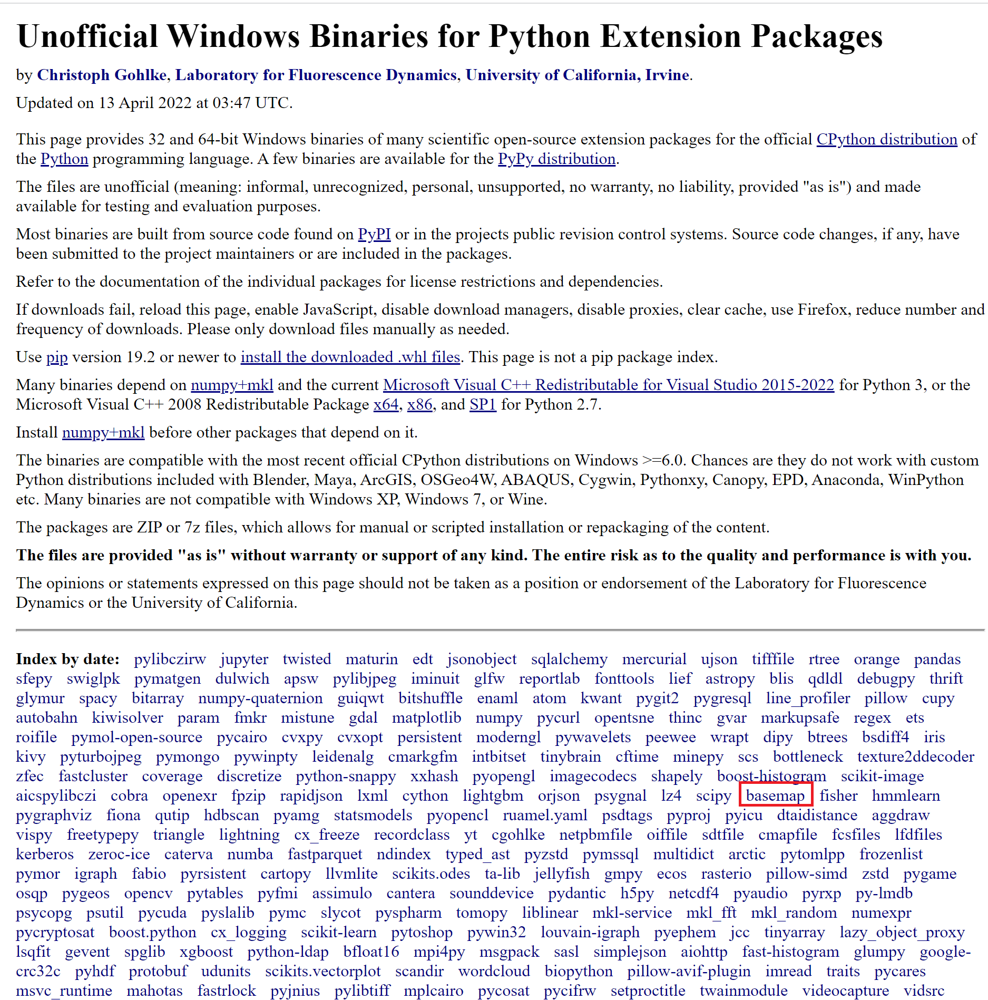

In [21]:
Image('downloading_BASEMAP_whl/1_basemap.png')

### File version
Before downloading the file, we need to make sure what is the Python version and the windows bit
- EG: I have python 3.9 version with win 64 bit. So I will download the file as described below where cp39 is the python version 3.9 and win-amd64 is the windows 64 bit in my computer
    * <b>filename:</b> basemap-1.3.2-cp39-cp39-win-amd64.whl
- Normally, the common setup is to go with 3.8

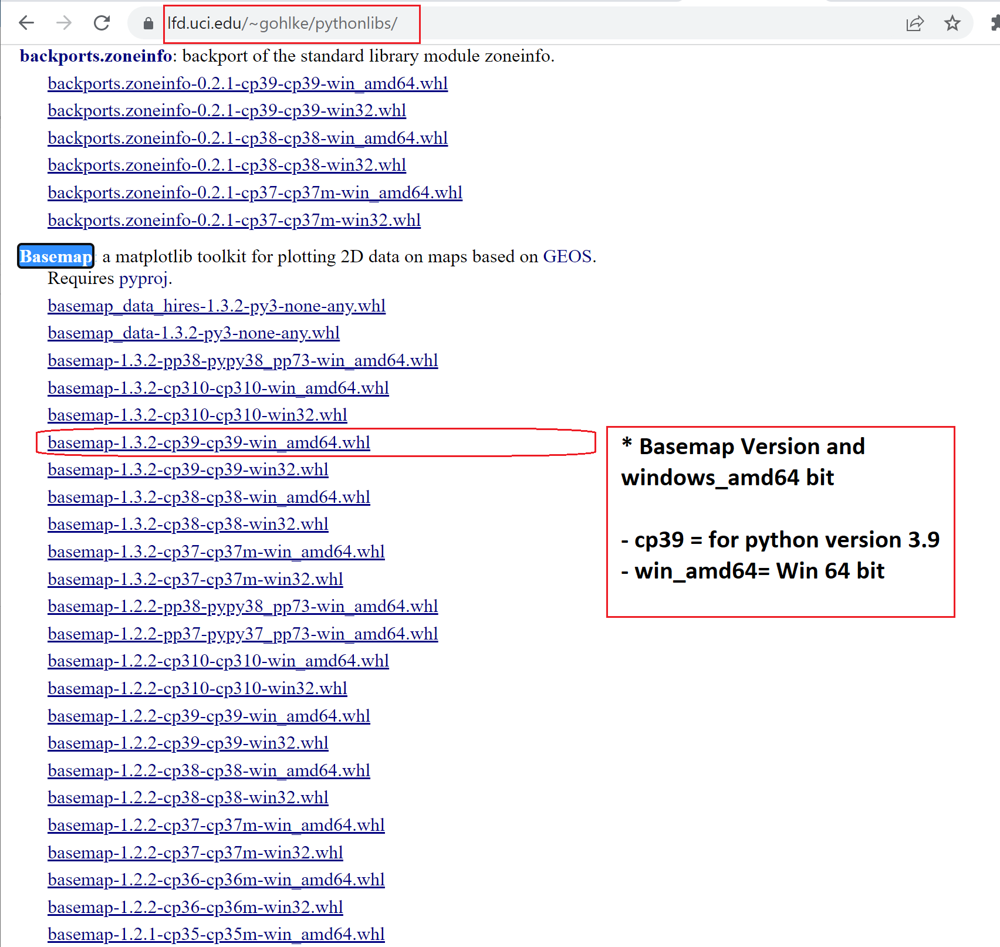

In [22]:
Image('downloading_BASEMAP_whl/2_basemap_source.png')

## Saving the file in the desired location
- We can install the file by locating the path
- EG: 
    pip install 'path' basemap-1.3.2-cp39-cp39-win-amd64.whl

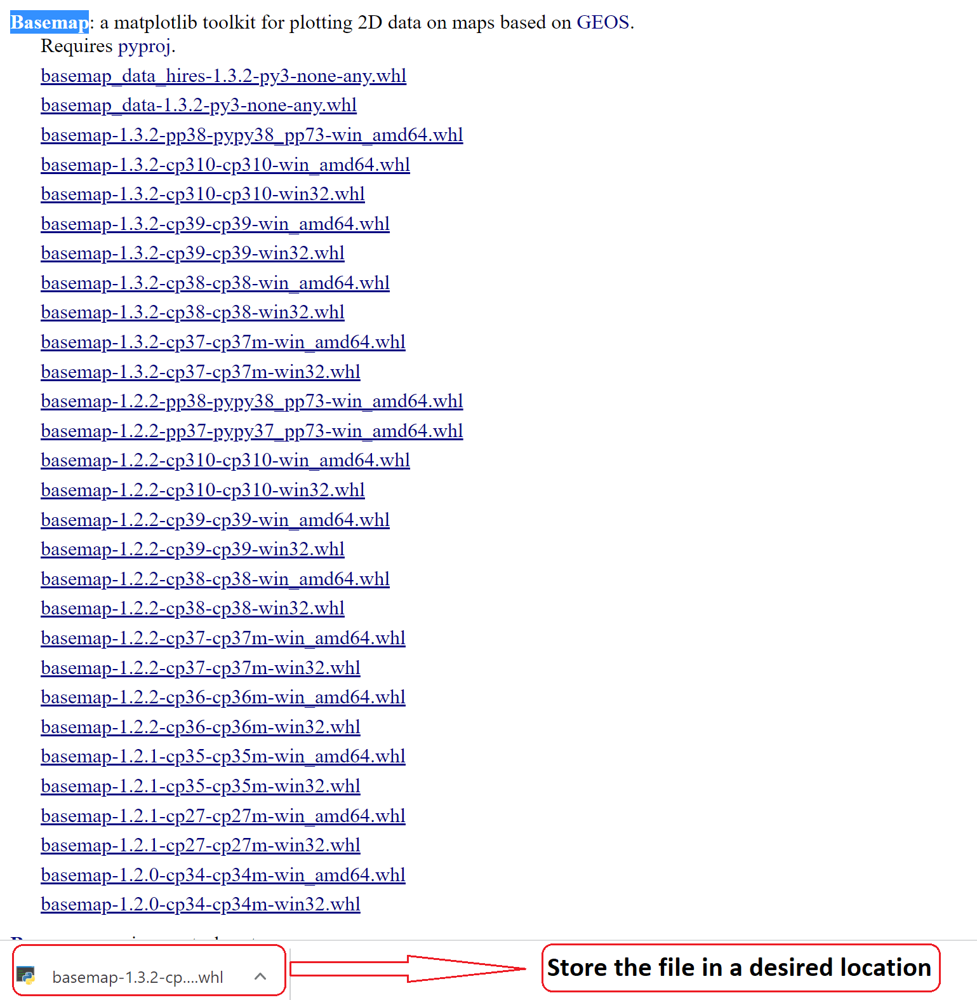

In [23]:
Image('downloading_BASEMAP_whl/3_basemap_file.png')

## Installing the 'basemap' file with pip

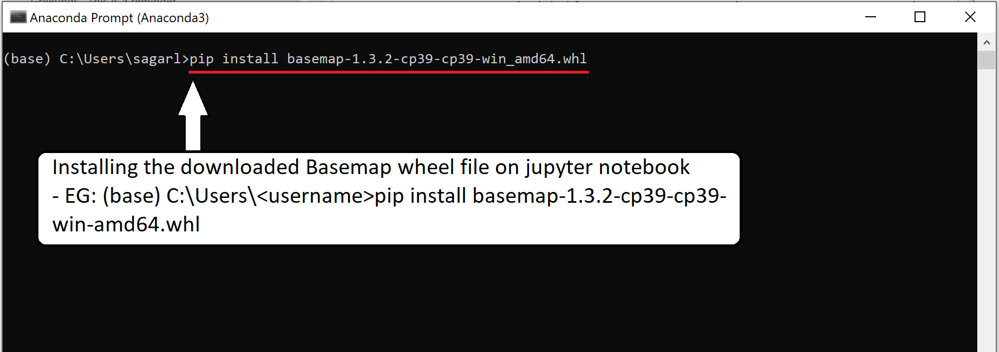

In [24]:
Image('downloading_BASEMAP_whl/4_install_file.png')

In [25]:
%%time
def global_coverage(data, title):
    
# coordinate for global coverage
    lats = np.random.randint(-75, 75, size=20)
    lons = np.random.randint(-179, 179, size=20)

    fig = plt.gcf()
    fig.set_size_inches(18, 12)

    m= Basemap(projection='cyl', resolution='c',
                   llcrnrlat= -90, urcrnrlat=90, llcrnrlon= -180, urcrnrlon= 90)

    m.scatter( data['longitude'][:], data['latitude'][:], c= data['xco2'][:], 
              cmap= plt.cm.turbo, 
              s=5,
              marker='*')

    m.bluemarble()   # full scale will be overkill
    m.drawcoastlines(color='white', linewidth=0.2)  # add coastlines

    # Customizing the COLORBAR
    cbar= plt.colorbar(orientation= "horizontal",
                      format= "%.0f",
                      extend="both",
                      shrink= 0.45,
                      aspect= 10,
                      pad= 0.04)

    cbar.set_label(label="XCO2 (parts per million)", size= 15)
    cbar.ax.tick_params(labelsize= 15)

    # ADJUSTT the Color Bar by year
#     min_xco2= np.min(data['xco2'])
#     max_xco2= np.max(data['xco2'])

    min_xco2= 390
    max_xco2= 425
    
    cbar.set_ticks(np.linspace(min_xco2, max_xco2, 5))
    plt.clim(min_xco2, max_xco2)
    plt.title("XCO2- "+ str(title) + " Atmospheric Carbon Dioxide", fontsize= 19)

    plt.show()

Wall time: 0 ns


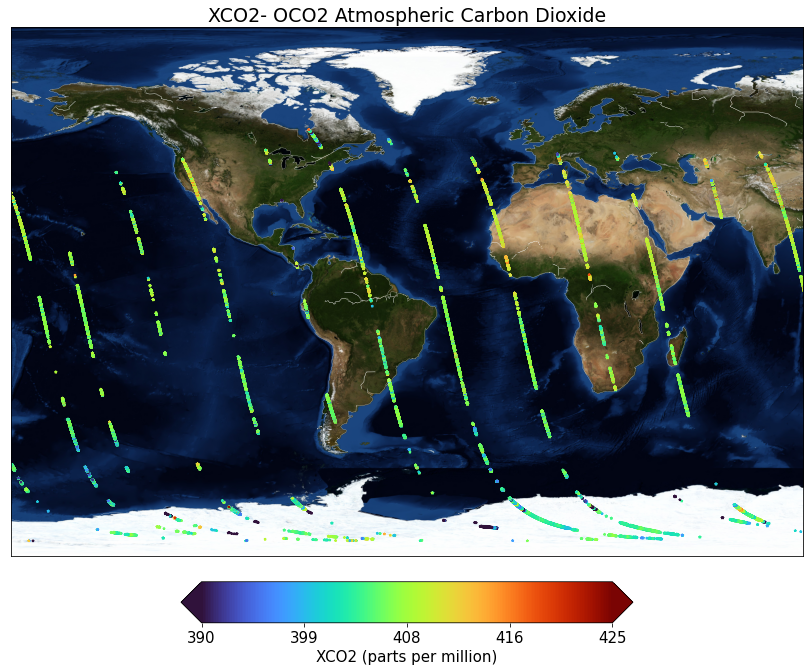

Wall time: 38.2 s


In [26]:
%%time
global_coverage(df_xr, "OCO2")

In [27]:
# Questions:
# 4. Example two- Show same plot but over several years
# 5. Example three- Same location and time but shown over Google Earth for OCO-2 data
# 6. Example four- Same location and time but show over Google Earth for OCO-3 data
# 7. Example five – GIF showing OCO-3 data on spinning globe

## 6. Example four- Same location and time but show over Google Earth for OCO-3 data

### OCO3 data retrieval and visualization

Open the OCO3 dataset as same steps for OCO2
- xarray.open_dataset('path to file')

In [28]:
%%time
df_oco3= xarray.open_dataset('../../oco3_LtCO2_190902_B10205Xr_200608195702s.nc4')

Wall time: 529 ms


## Display the OCO3 dataframe
- Information on dimension, levels, bands, products

In [29]:
df_oco3.head(8)

<xarray.Dataset>
Dimensions:                (sounding_id: 8, levels: 8, bands: 3, vertices: 4,
                            epoch_dimension: 7, source_files: 8)
Coordinates:
  * sounding_id            (sounding_id) float64 2.019e+15 ... 2.019e+15
  * levels                 (levels) int16 1 2 3 4 5 6 7 8
  * bands                  (bands) int16 1 2 3
  * vertices               (vertices) int16 1 2 3 4
  * source_files           (source_files) object '/oco3/product/Ops_B10202_r0...
Dimensions without coordinates: epoch_dimension
Data variables: (12/18)
    date                   (sounding_id, epoch_dimension) float32 ...
    latitude               (sounding_id) float32 ...
    longitude              (sounding_id) float32 ...
    time                   (sounding_id) datetime64[ns] ...
    solar_zenith_angle     (sounding_id) float32 ...
    sensor_zenith_angle    (sounding_id) float32 ...
    ...                     ...
    xco2_uncertainty       (sounding_id) float32 ...
    xco2_apriori           (sounding_id) float32 ...
    pressure_levels        (sounding_id, levels) float32 ...
    co2_profile_apriori    (sounding_id, levels) float32 ...
    xco2_averaging_kernel  (sounding_id, levels) float32 ...
    pressure_weight        (sounding_id, levels) float32 ...
Attributes: (12/22)
    identifier_product_doi:            Unassigned
    identifier_product_doi_authority:  http://dx.doi.org/
    filter_function:                   oco3_xco2_quality_flag_b10_vearly
    bc_function:                       oco3_xco2_bias_correct_b10_vearly
    warn_level_function:               From_L2Std
    Bias_Correction_oceanGL:           XCO2_Bias_Corrected = (XCO2_Raw + 0.20...
    ...                                ...
    CollectionLabel:                   Ops_B10202_r02
    L2FullPhysicsExeVersion:           SVN-B10.2.00_sdos_testing_1-35426
    title:                             ACOS L2 Lite Output
    filtering state:                   Filtered with oco3_lite_file_prefilter...
    creation_date:                     Jun 2020
    contact:                           Chris O'Dell: odell@atmos.colostate.edu

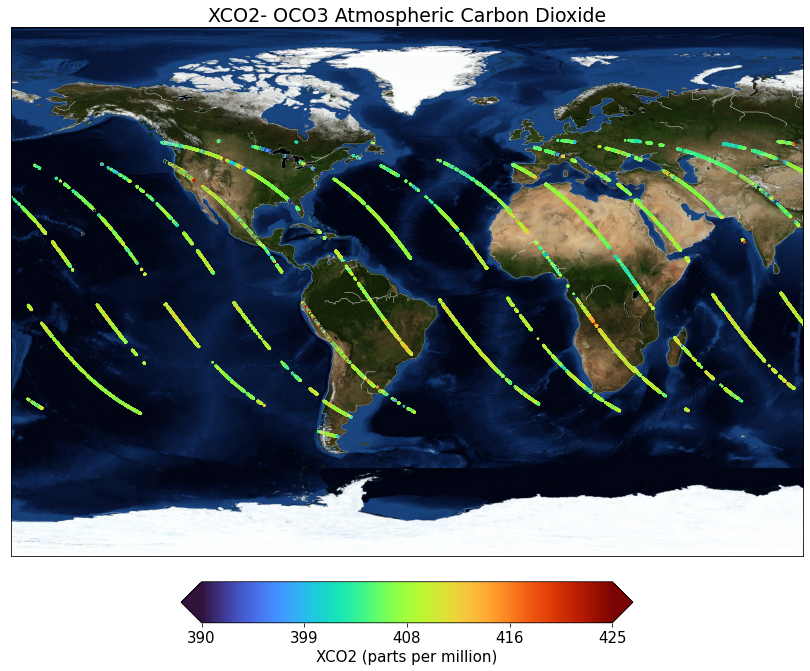

Wall time: 40 s


In [30]:
%%time
global_coverage(df_oco3, "OCO3")

## 7. Example five – GIF showing OCO-3 data on spinning globe

In [32]:
# %%time
# plt.figure(figsize=(4, 4))

# def decorate_axes(ax):
#     ax.set_global()
#     ax.coastlines()


# def animate(i):
#     lon = i
#     ax = plt.gca()
#     ax.remove()

#     ax = plt.axes([0, 0, 1, 1], projection=ccrs.Orthographic(
#         central_latitude=0, central_longitude=lon))

# #     ax= plt.scatter(x= df_xco2['Longitude'], y=df_xco2['Latitude'],
# #                    c= 'dodgerblue')
#     decorate_axes(ax)

# ani = animation.FuncAnimation(
#     plt.gcf(), animate,
#     frames=np.linspace(0, 360, 90),
#     interval=125, repeat=False)

# #ani.save('poc.gif', writer='imagemagick', dpi=plt.gcf().dpi)

# video = ani.to_html5_video()
# html = display.HTML(video)
# display.display(html)
# plt.close() 
